In [16]:
#Atropy of rgb image

In [17]:
%matplotlib inline

In [18]:
#import libraries

In [19]:
from PIL import Image
import numpy as np
from skimage import data
from skimage.morphology import disk
from matplotlib import pyplot as plt
from skimage.filters.rank import entropy
import math

In [20]:
#loading images

In [21]:
im = Image.open('samples/29  ≥π‹ Í⁄√≈.bmp')
im2 = Image.open('samples/30  ≥π‹ ≥›◊¥œﬂ.bmp')
im3 = Image.open('samples/34  ≥π‹÷–…œ.bmp')

npimg1 = np.array(im);
npimg2 = np.array(im2);
npimg3 = np.array(im3);
print(npimg1.shape,npimg2.shape,npimg3.shape);

((1080, 1920, 3), (1080, 1920, 3), (1080, 1920, 3))


In [22]:
#TEST FROM SCIKIT-IMAGE DATA

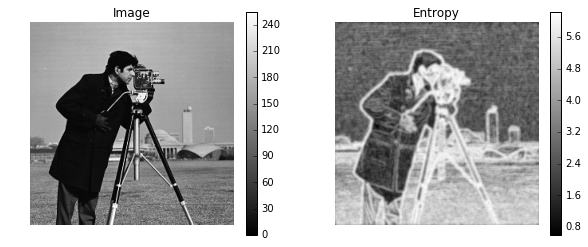

In [23]:

image = data.camera()

fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(10, 4), sharex=True, sharey=True)

fig.colorbar(ax1.imshow(image, cmap=plt.cm.gray), ax=ax1)
ax1.set_title('Image')
ax1.axis('off')
ax1.set_adjustable('box-forced')

fig.colorbar(ax2.imshow(entropy(image, disk(5)), cmap=plt.cm.gray), ax=ax2)
ax2.set_title('Entropy')
ax2.axis('off')
ax2.set_adjustable('box-forced')

In [24]:
#ADAPTING TO RGB

In [25]:
from skimage.color.adapt_rgb import adapt_rgb, each_channel, hsv_value
from skimage import filters

selem = disk(5)

#TODO SHOULD PLAY WITH THE STRUCTURE ELEMENT FOR DIFFERENT RESULTS


@adapt_rgb(each_channel)
def entropy_each(image):
    return entropy(image,selem)

@adapt_rgb(hsv_value)
def entropy_hsv(image):
    return entropy(image,selem)

In [26]:
#APLYING TO SAMPLE

3


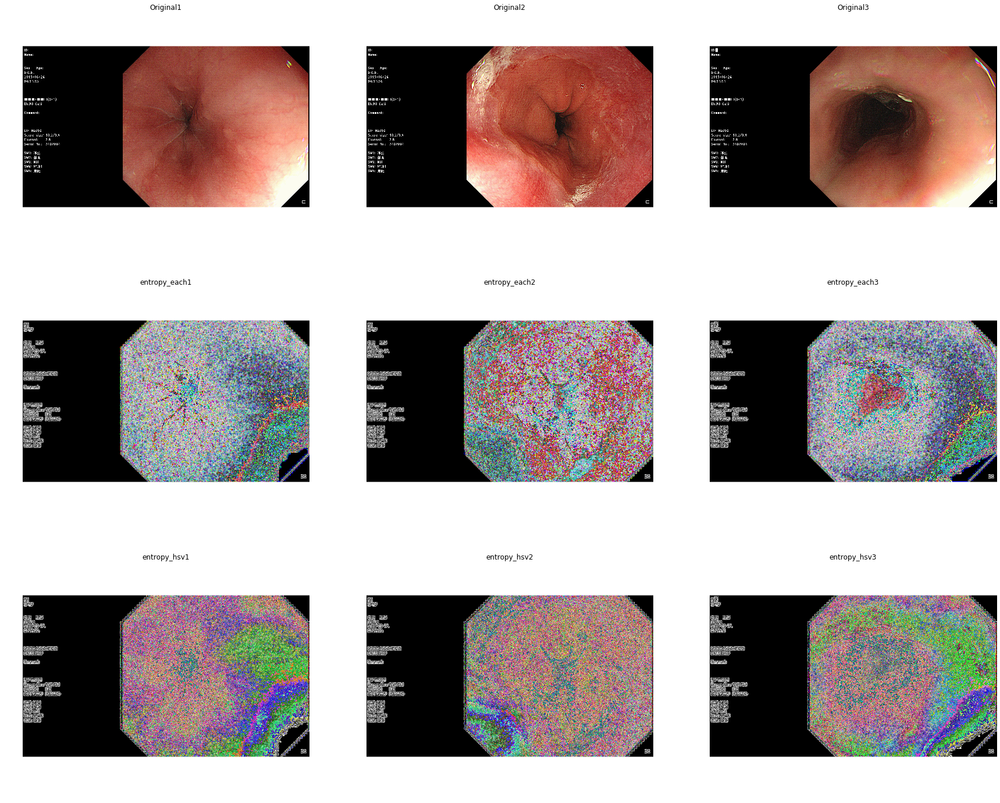

In [27]:
import math 

targetImg_titles = ['Original1','Original2','Original3']
srcImg = [npimg1,npimg2,npimg3]
displayImg = [npimg1,npimg2,npimg3]
myFiltersNames = ['entropy_each','entropy_hsv']
myFilters = [entropy_each,entropy_hsv]

#Dynamically prepare data for plotting
for n in range(0,len(myFilters)):
    for m in range(0,len(srcImg)):
        displayImg.append(myFilters[n](srcImg[m]))
        targetImg_titles.append(myFiltersNames[n]+str(m+1))
    

#Dynamically plotting
mycols = len(srcImg)
myrows = int(math.ceil(float(len(displayImg))/float(mycols)))
print(myrows)
fig, axes= plt.subplots(myrows, mycols, figsize=(30, 8*myrows), sharex=True, sharey=True)
ax = axes.ravel()

for rrr in range(mycols*myrows):
    ax[rrr].imshow(displayImg[rrr],cmap='gray')
    ax[rrr].set_title(targetImg_titles[rrr])
    ax[rrr].axis('off')
    
plt.show()

In [28]:
#SCALLING INTENSITES  ****dick of 10 gives better results****

In [29]:
from skimage.exposure import rescale_intensity

3


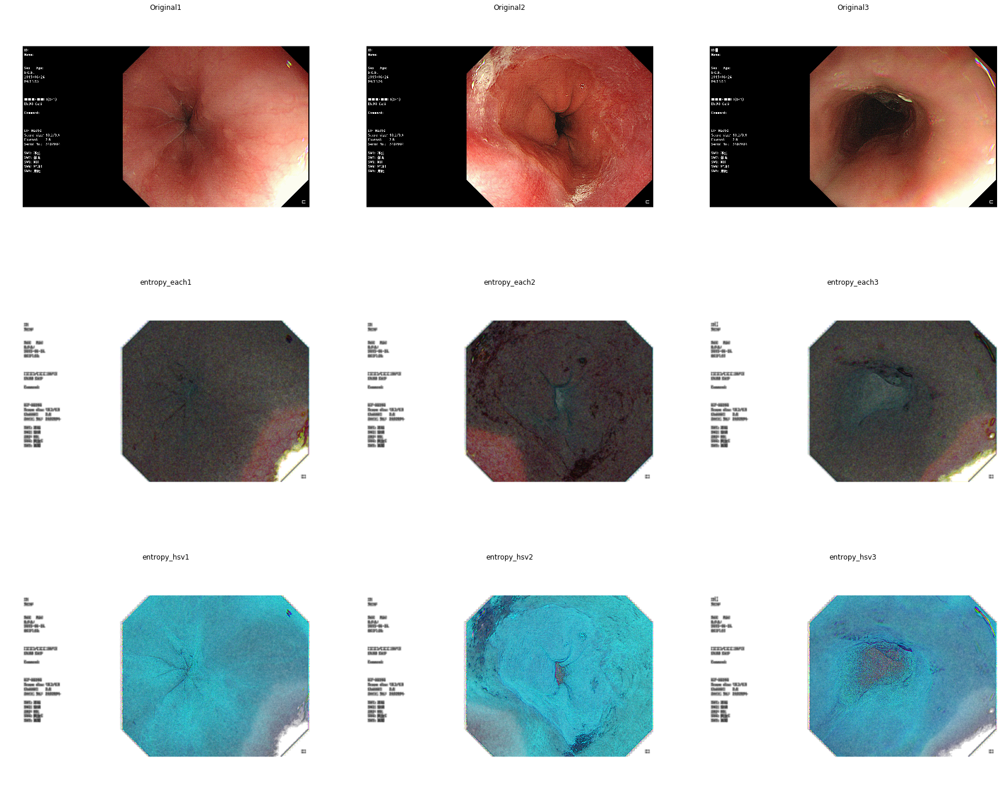

In [30]:
import math 

targetImg_titles = ['Original1','Original2','Original3']
srcImg = [npimg1,npimg2,npimg3]
displayImg = [npimg1,npimg2,npimg3]
myFiltersNames = ['entropy_each','entropy_hsv']
myFilters = [entropy_each,entropy_hsv]

#Dynamically prepare data for plotting
for n in range(0,len(myFilters)):
    for m in range(0,len(srcImg)):
        displayImg.append(1-rescale_intensity(myFilters[n](srcImg[m])))
        targetImg_titles.append(myFiltersNames[n]+str(m+1))
    

#Dynamically plotting
mycols = len(srcImg)
myrows = int(math.ceil(float(len(displayImg))/float(mycols)))
print(myrows)
fig, axes= plt.subplots(myrows, mycols, figsize=(30, 8*myrows), sharex=True, sharey=True)
ax = axes.ravel()

for rrr in range(mycols*myrows):
    ax[rrr].imshow(displayImg[rrr],cmap='gray')
    ax[rrr].set_title(targetImg_titles[rrr])
    ax[rrr].axis('off')
    
plt.show()

In [31]:
#APLYING TO FILTERD SAMPLES

In [32]:
from skimage.color.adapt_rgb import adapt_rgb, each_channel, hsv_value
from skimage.filters import rank
from skimage.morphology import disk

selem = disk(20)

@adapt_rgb(each_channel)
def mean_percentile_each(image):
    return rank.mean_percentile(image, selem=selem, p0=.1, p1=.9)

@adapt_rgb(hsv_value)
def mean_percentile_hsv(image):
    return rank.mean_percentile(image, selem=selem, p0=.1, p1=.9)


@adapt_rgb(each_channel)
def mean_bilateral_each(image):
    return rank.mean_bilateral(image, selem=selem, s0=500, s1=500)

@adapt_rgb(hsv_value)
def mean_bilateral_hsv(image):
    return rank.mean_bilateral(image, selem=selem, s0=500, s1=500)


@adapt_rgb(each_channel)
def mean_each(image):
    return rank.mean(image, selem=selem)

@adapt_rgb(hsv_value)
def mean_hsv(image):
    return rank.mean(image, selem=selem)


@adapt_rgb(each_channel)
def median_each(image):
    return rank.median(image, selem=selem)

@adapt_rgb(hsv_value)
def median_hsv(image):
    return rank.median(image, selem=selem)


In [33]:
from skimage.color.adapt_rgb import adapt_rgb, each_channel, hsv_value
from skimage import filters

selem = disk(5)

#TODO SHOULD PLAY WITH THE STRUCTURE ELEMENT FOR DIFFERENT RESULTS


@adapt_rgb(each_channel)
def entropy_each(image):
    return entropy(image,selem)

@adapt_rgb(hsv_value)
def entropy_hsv(image):
    return entropy(image,selem)

In [48]:
#without rescaling intensities

17


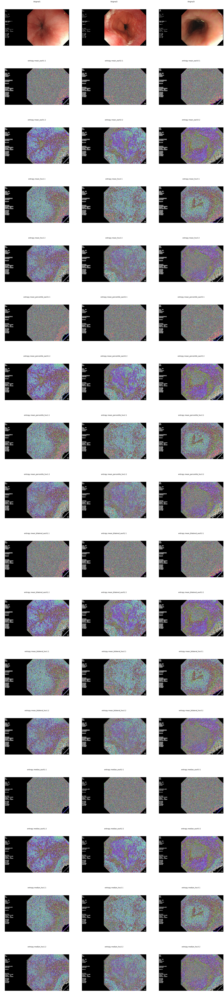

In [50]:
import math 

targetImg_titles = ['Original1','Original2','Original3']
srcImg = [npimg1,npimg2,npimg3]
displayImg = [npimg1,npimg2,npimg3]
myFiltersNames = ['entropy mean_each','entropy mean_hsv','entropy mean_percentile_each',
                  'entropy mean_percentile_hsv','entropy mean_bilateral_each','entropy mean_bilateral_hsv'
                  ,'entropy median_each','entropy median_hsv']
myEntropies = [entropy_each,entropy_hsv]
myFilters = [mean_each,mean_hsv,mean_percentile_each,mean_percentile_hsv
             ,mean_bilateral_each,mean_bilateral_hsv,median_each,median_hsv]


#Dynamically prepare data for plotting
for n in range(0,len(myFilters)):
        for k in range(0,len(myEntropies)):
             for m in range(0,len(srcImg)):
                    displayImg.append(myEntropies[k](myFilters[n](srcImg[m])))
                    targetImg_titles.append(myFiltersNames[n]+str(m+1)+":"+str(k+1))


      

#Dynamically plotting
mycols = len(srcImg)
myrows = int(math.ceil(float(len(displayImg))/float(mycols)))
print(myrows)
fig, axes= plt.subplots(myrows, mycols, figsize=(30, 8*myrows), sharex=True, sharey=True)
ax = axes.ravel()

for rrr in range(mycols*myrows):
    ax[rrr].imshow(displayImg[rrr],cmap='gray')
    ax[rrr].set_title(targetImg_titles[rrr])
    ax[rrr].axis('off')
    
plt.show()


In [49]:
#Rescalling intensities

In [51]:
from skimage.exposure import rescale_intensity

17


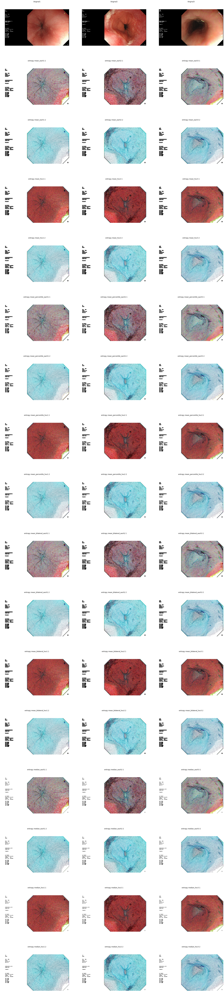

In [47]:
import math 

targetImg_titles = ['Original1','Original2','Original3']
srcImg = [npimg1,npimg2,npimg3]
displayImg = [npimg1,npimg2,npimg3]
myFiltersNames = ['entropy mean_each','entropy mean_hsv','entropy mean_percentile_each',
                  'entropy mean_percentile_hsv','entropy mean_bilateral_each','entropy mean_bilateral_hsv'
                  ,'entropy median_each','entropy median_hsv']
myEntropies = [entropy_each,entropy_hsv]
myFilters = [mean_each,mean_hsv,mean_percentile_each,mean_percentile_hsv
             ,mean_bilateral_each,mean_bilateral_hsv,median_each,median_hsv]


#Dynamically prepare data for plotting
for n in range(0,len(myFilters)):
        for k in range(0,len(myEntropies)):
             for m in range(0,len(srcImg)):
                    displayImg.append(1- rescale_intensity(myEntropies[k](myFilters[n](srcImg[m]))))
                    targetImg_titles.append(myFiltersNames[n]+str(m+1)+":"+str(k+1))


      

#Dynamically plotting
mycols = len(srcImg)
myrows = int(math.ceil(float(len(displayImg))/float(mycols)))
print(myrows)
fig, axes= plt.subplots(myrows, mycols, figsize=(30, 8*myrows), sharex=True, sharey=True)
ax = axes.ravel()

for rrr in range(mycols*myrows):
    ax[rrr].imshow(displayImg[rrr],cmap='gray')
    ax[rrr].set_title(targetImg_titles[rrr])
    ax[rrr].axis('off')
    
plt.show()


In [36]:
#RENYI ANTROPY

In [37]:
#renyi function

In [44]:
import skimage.exposure as imexp

def renyi_seg_fn(im,alpha,coef):
    hist = imexp.histogram(im)
    
    #convert all values to float
    hist_float = [float(i) for i in hist[0]]
    
    #compute the pdf
    pdf = hist_float/np.sum(hist_float)
    
    #compute the cdf
    cumsum_pdf = np.cumsum(pdf)
    
    s = 0
    e = 255 # asuming 8 bit image
    scalar  = 1.0/(1-alpha)
    
    #A very small balue to prevent divition by zero
    eps = np.spacing(1)
    rr= e-s
    
    #the second parentheses is needed because the parameters are tuple
    h1 = np.zeros((rr,1))
    h2 = np.zeros((rr,1))
    
    #the following llop coputes h1 and h2 values used to compute the entropy
#     print (len(pdf),len(cumsum_pdf))
    for ii in range(1,rr):
           
        iidash = ii+s
        if(iidash==len(pdf)):   #temporatry fix for out of bound issue
            break
        temp1 = np.power(pdf[1:iidash]/cumsum_pdf[iidash],scalar)
        h1[ii] = np.log(np.sum(temp1)+eps)
        temp2 = np.power(pdf[iidash+1:255]/(1-cumsum_pdf[iidash]),scalar)
        h2[ii] = np.log(np.sum(temp2)+eps)
        
    T = h1 + h2
    
    #Entropy value is calculated 
    T = -T*scalar
    
    
    #location where the maximum entropy occurs is the threshold for the renyi entropy
    location = T.argmax(axis=0)
    
    sortedLocation = sorted(T.ravel())
    
    print(max(sortedLocation))
    print(sortedLocation[-3:])
    print(sortedLocation[:2])
    print(location)
    
    #show histogram
    
#     fig, axes= plt.subplots(1, 1, figsize=(10, 5), sharex=True, sharey=True)
    
#     axes.hist(location)
#     plt.show()
   
    
    #location value is used as the threshold
    thresh = location
    
    print (thresh)
    threshedImg = im < thresh*coef
    print ("done--")
    
    return threshedImg

In [39]:
#renyi adapted to rgb

In [45]:
from skimage.color.adapt_rgb import adapt_rgb, each_channel, hsv_value


#TODO SHOULD PLAY WITH THE STRUCTURE ELEMENT FOR DIFFERENT RESULTS


@adapt_rgb(each_channel)
def renyi_seg_each(image,alpha,coef):
    return renyi_seg_fn(image,alpha,coef)

@adapt_rgb(hsv_value)
def renyi_seg_hsv(image,alpha,coef):
    return renyi_seg_fn(image,alpha,coef)

In [41]:
#APPLYING TO SAMPLE IMAGES

12.278747912
[12.27651684219995, 12.277590726998245, 12.278747911971035]
[-17.296783175179055, -17.134049302396448]
[61]
[61]
done--
11.8202811269
[11.819860533684849, 11.820198534747526, 11.820281126912393]
[-17.462565661426495, -17.28248251226114]
[61]
[61]
done--
11.8953692043
[11.894873542089314, 11.895068542619825, 11.895369204285277]
[-17.283535289800639, -17.154420603795657]
[51]
[51]
done--
12.3582086186
[12.356952920314072, 12.357836888268503, 12.358208618567597]
[-17.258985593562404, -17.136385854916615]
[79]
[79]
done--
12.017452602
[12.016958016945503, 12.017444843305428, 12.017452601980068]
[-17.249463911624019, -17.080210636213682]
[60]
[60]
done--
12.588345378
[12.587929383332874, 12.587960753599585, 12.588345377959442]
[-16.524686028960179, -16.352461204040008]
[46]
[46]
done--
11.7640896613
[11.763741037157297, 11.764085048058229, 11.764089661339861]
[-17.570041796450546, -17.467539145679005]
[103]
[103]
done--
11.7419178443
[11.741693704382152, 11.741903201245666, 11.

/Users/rolland/anaconda2/lib/python2.7/site-packages/ipykernel/__main__.py:36: RuntimeWarning: divide by zero encountered in power
/Users/rolland/anaconda2/lib/python2.7/site-packages/ipykernel/__main__.py:34: RuntimeWarning: divide by zero encountered in power


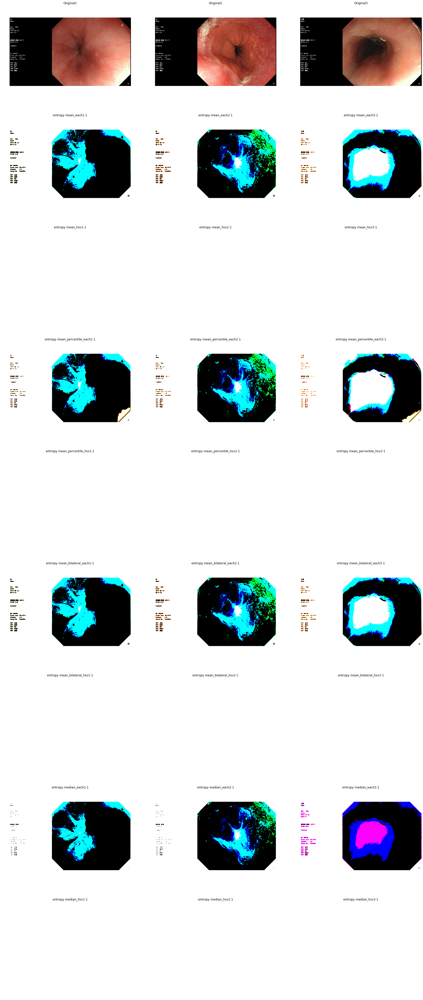

In [52]:
import math 

targetImg_titles = ['Original1','Original2','Original3']
srcImg = [npimg1,npimg2,npimg3]
displayImg = [npimg1,npimg2,npimg3]
myFiltersNames = ['entropy mean_each','entropy mean_hsv','entropy mean_percentile_each', 'entropy mean_percentile_hsv'
                  ,'entropy mean_bilateral_each','entropy mean_bilateral_hsv'
                  ,'entropy median_each','entropy median_hsv']
myEntropies = [renyi_seg_each]
myFilters = [mean_each,mean_hsv,mean_percentile_each,mean_percentile_hsv
             ,mean_bilateral_each,mean_bilateral_hsv,median_each,median_hsv]




 
###the higher the value of alpha the fewer the number of abnormal tissues detected
#alpha = 3
alpha = 2.5    
###this coeficient is needed the detect the abonomal soft tissues
# coef = 0.01
coef = 1

#Dynamically prepare data for plotting
for n in range(0,len(myFilters)):
        for k in range(0,len(myEntropies)):
               for m in range(0,len(srcImg)):
                    displayImg.append(myEntropies[k](myFilters[n](srcImg[m]),alpha,coef))
                    targetImg_titles.append(myFiltersNames[n]+str(m+1)+":"+str(k+1))
            
         

#Dynamically plotting
mycols = len(srcImg)
myrows = int(math.ceil(float(len(displayImg))/float(mycols)))
print(myrows)
fig, axes= plt.subplots(myrows, mycols, figsize=(30, 8*myrows), sharex=True, sharey=True)
ax = axes.ravel()

for rrr in range(mycols*myrows):
    ax[rrr].imshow(displayImg[rrr],cmap='gray')
    ax[rrr].set_title(targetImg_titles[rrr])
    ax[rrr].axis('off')
    
plt.show()
